In [28]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [29]:
import os
import cv2
import torch
import torch.utils.data
import torchvision
import labelme2coco
import IPython
from PIL import Image
from pycocotools.coco import COCO
from matplotlib import pyplot as plt
import torch as t
from torchvision.transforms import ToPILImage as to_img
from IPython.display import Image as display_image

from engine import train_one_epoch, evaluate
from functions import ChessBoardsDataSet, get_transform, collate_fn

In [30]:
def imshow(img):
    img = to_img(img)
    display_image(img)

In [31]:
labelme_folder = "data/example_boards/"
coco_json_path = "./boards_annotations_coco.json"
labelme2coco.convert(labelme_folder, coco_json_path)


In [32]:
# select device (whether GPU or CPU)
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

## path to your own data and coco file
train_data_dir = './'
train_coco = coco_json_path

# create own Dataset
dataset = ChessBoardsDataSet(root=train_data_dir,
                              annotation=train_coco)

dataset_test = ChessBoardsDataSet(root=train_data_dir,
                                  annotation=train_coco)

# split the dataset in train and test set
indices = torch.randperm(len(dataset)).tolist()
#dataset = torch.utils.data.Subset(dataset, indices[:-5])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-5:])

# Batch size
train_batch_size = 6
torch.set_num_threads(4)

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=train_batch_size, shuffle=True, num_workers=0,
    collate_fn=collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=0,
    collate_fn=collate_fn)


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 576, 1024])
torch.Size([576, 1024])


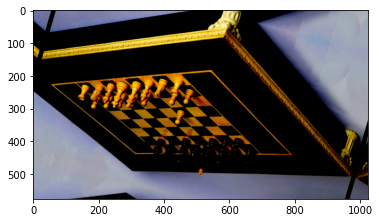

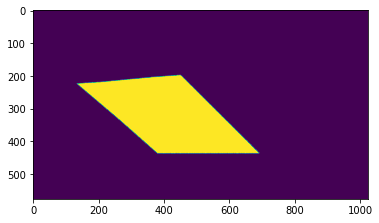

In [33]:
# DataLoader is iterable over Dataset
for images, targets in iter(data_loader):
    #plt.figure()
    plt.imshow(images[0].permute(1,2,0))
    plt.figure()
    plt.imshow(targets[0]["masks"][0].permute(0,1))

    print(images[0].shape)
    print(targets[0]["masks"][0].shape)

    break

In [22]:
!jupyter nbextension enable --py widgetsnbextension

/bin/bash: jupyter: command not found


In [34]:
from models import get_board_segmentation_model_instance

In [ ]:
num_classes = 2
num_epochs = 150
model = get_board_segmentation_model_instance(num_classes)

# move model to the right device
model.to(device)

len_dataloader = len(data_loader)
print(len_dataloader)

# construct an optimizer
init_lr = 0.0005
weight_decay = 0.0001
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.AdamW(params, lr=init_lr, weight_decay=weight_decay)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, verbose=True, patience=2, factor=0.75)

loss_mask_best = 1.0

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    metric_logger = train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=len_dataloader//2)
    loss_mask = metric_logger.loss_mask.global_avg

    if loss_mask < loss_mask_best:
        loss_mask_best = loss_mask
        torch.save(model.state_dict(), "./boards.model")
        print(f"model saved for loss_mask={loss_mask}")

    # update the learning rate
    scheduler.step(loss_mask)
    # evaluate on the test dataset
    #evaluate(model, data_loader_test, device=device)

print("training done")

52
Epoch: [0]  [ 0/52]  eta: 0:03:10  lr: 0.000010  loss: 4.1541 (4.1541)  loss_classifier: 0.7360 (0.7360)  loss_box_reg: 0.0675 (0.0675)  loss_mask: 3.2849 (3.2849)  loss_objectness: 0.0439 (0.0439)  loss_rpn_box_reg: 0.0218 (0.0218)  time: 3.6655  data: 0.0962  max mem: 10794
Epoch: [0]  [26/52]  eta: 0:00:58  lr: 0.000265  loss: 0.7253 (1.1930)  loss_classifier: 0.0565 (0.1612)  loss_box_reg: 0.0786 (0.0784)  loss_mask: 0.5616 (0.9160)  loss_objectness: 0.0184 (0.0262)  loss_rpn_box_reg: 0.0077 (0.0111)  time: 2.2385  data: 0.2482  max mem: 10794
Epoch: [0]  [51/52]  eta: 0:00:02  lr: 0.000500  loss: 0.6617 (0.9540)  loss_classifier: 0.0594 (0.1158)  loss_box_reg: 0.0930 (0.0881)  loss_mask: 0.4464 (0.7180)  loss_objectness: 0.0131 (0.0216)  loss_rpn_box_reg: 0.0098 (0.0105)  time: 2.2871  data: 0.1704  max mem: 10794
Epoch: [0] Total time: 0:01:59 (2.2981 s / it)
model saved for loss_mask=0.7179968861433176
Epoch: [1]  [ 0/52]  eta: 0:01:52  lr: 0.000500  loss: 0.4407 (0.4407)  lo

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [9]:
import math
from glob import glob
from random import shuffle
import numpy as np
import transforms as T
import scipy.spatial

device = torch.device('cpu')

model = get_board_segmentation_model_instance(2)
model.load_state_dict(torch.load("boards.model", map_location=device))
# model.cuda()
a = model.eval()

data/example_boards/start_lineups/0020-h-b.jpg


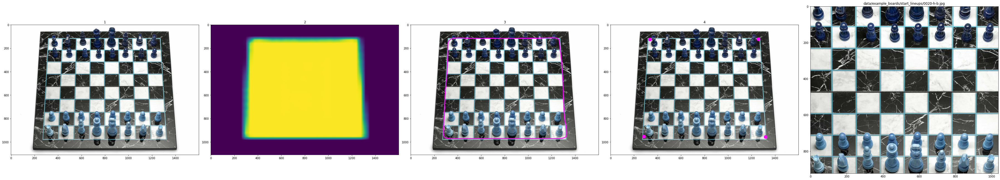

data/example_boards/gameplay/0146.jpeg


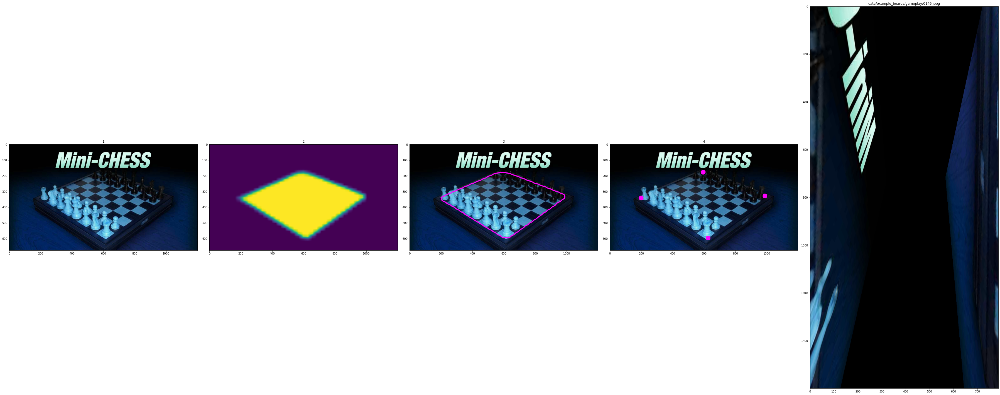

data/example_boards/gameplay/0093.jpeg


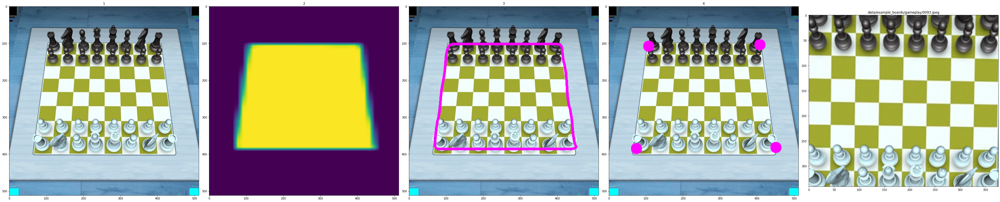

data/example_boards/gameplay/0051.jpeg


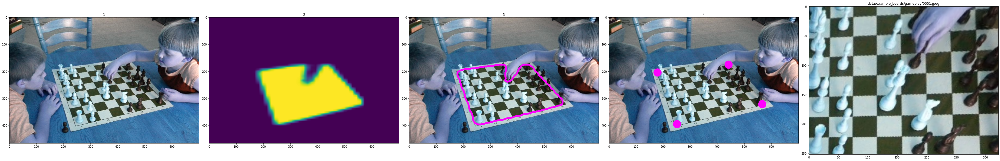

data/example_boards/gameplay/0182.jpeg


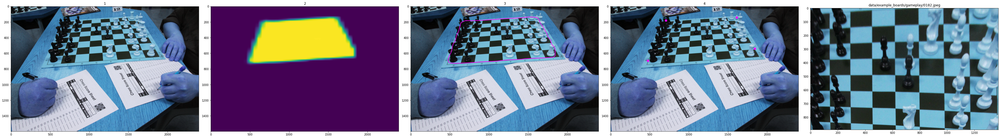

data/example_boards/gameplay/0190.jpeg


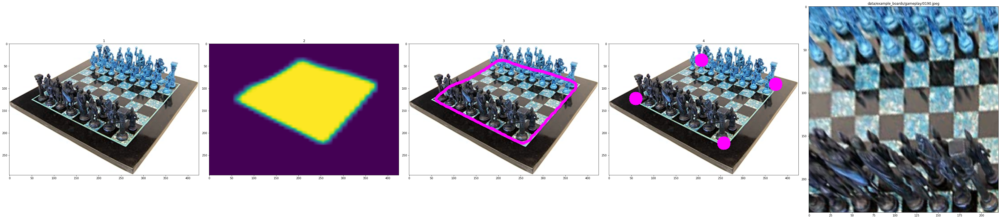

data/example_boards/gameplay/0167.jpeg


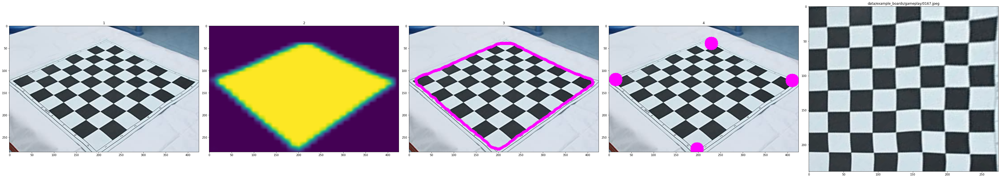

data/example_boards/gameplay/0010.jpg


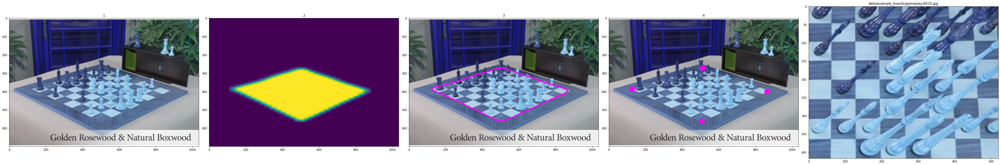

data/example_boards/from_videos/dscf2121.mov-4530.jpeg


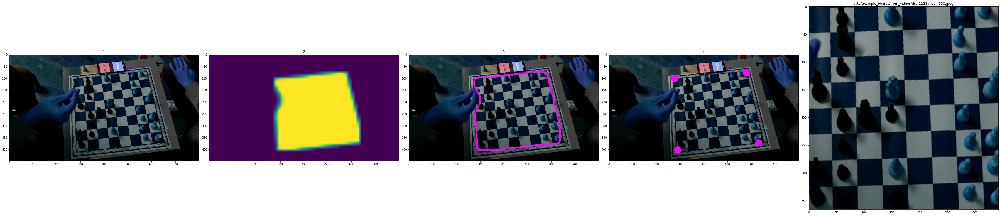

data/example_boards/gameplay/0100.jpeg


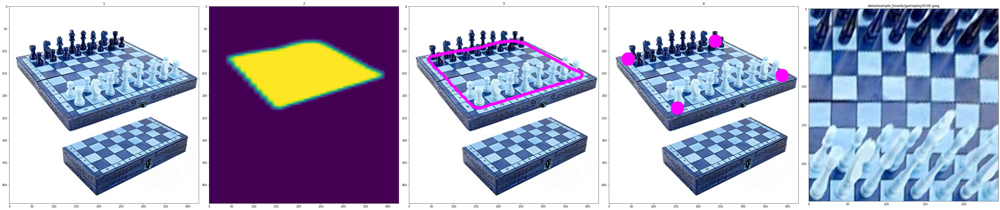

data/example_boards/from_videos/10_year_old_shown_no_mercy_by_famous_trash_talker!_boston_mike_vs_felix-nvaissbshno.mp4-152.jpeg


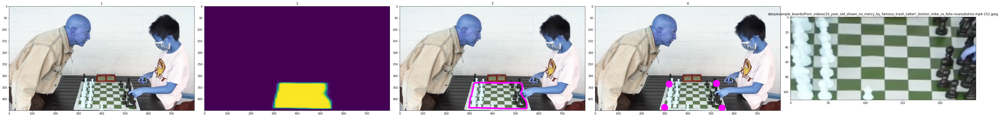

data/example_boards/gameplay/0187.jpeg


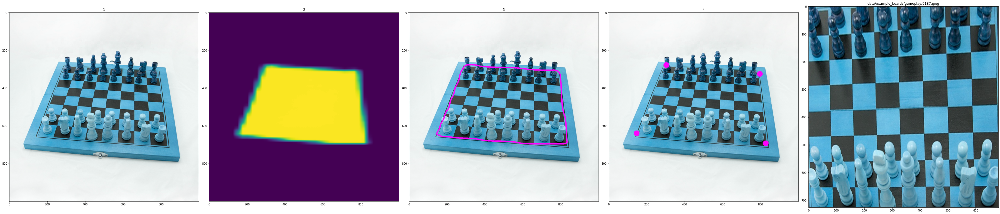

data/example_boards/gameplay/0099.jpeg


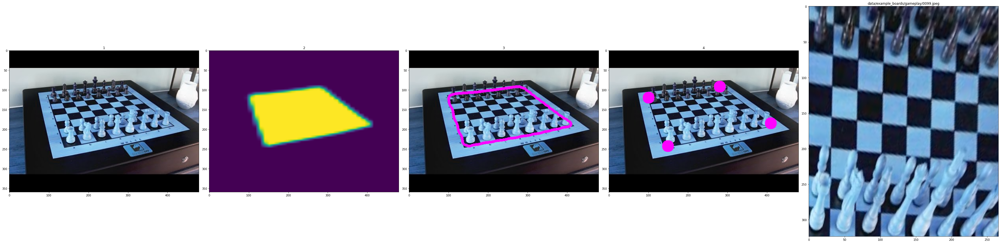

data/example_boards/from_videos/dscf2111.mov-2010.jpeg


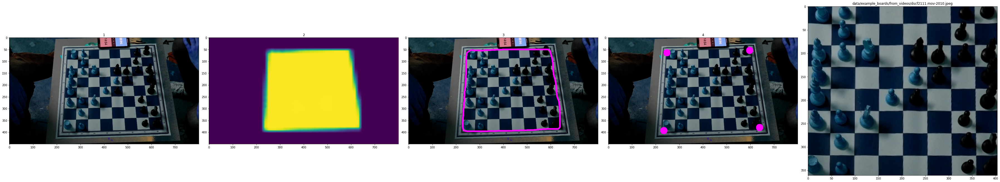

data/example_boards/gameplay/0175.jpeg


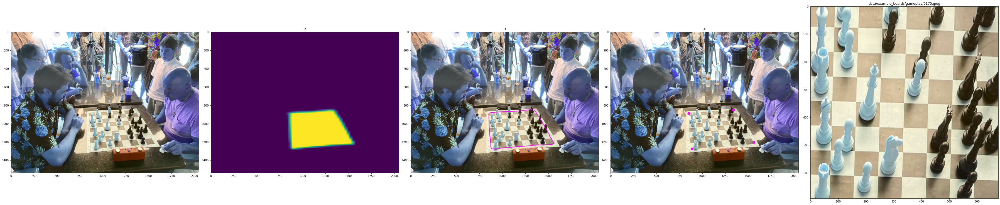

data/example_boards/gameplay/0144.jpeg


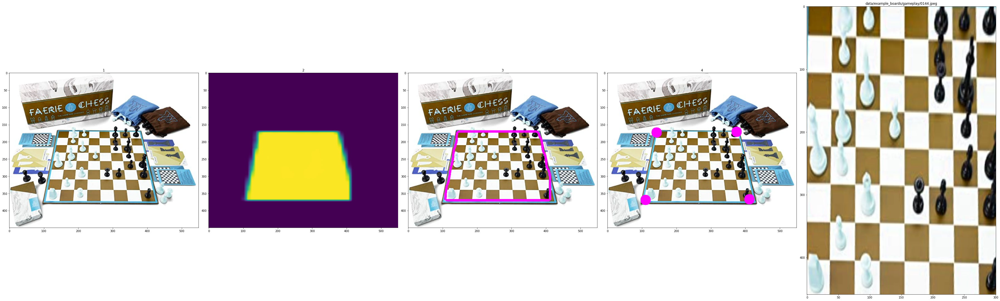

data/example_boards/gameplay/0016.jpg


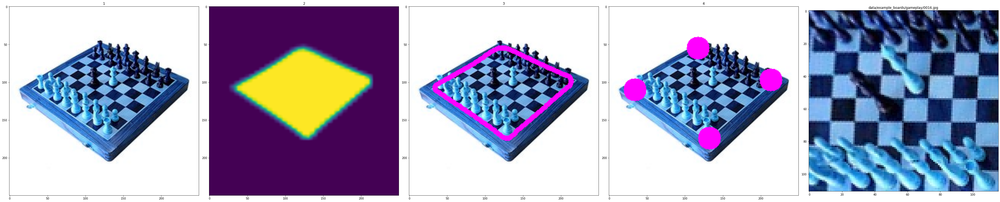

data/example_boards/gameplay/0064.jpeg


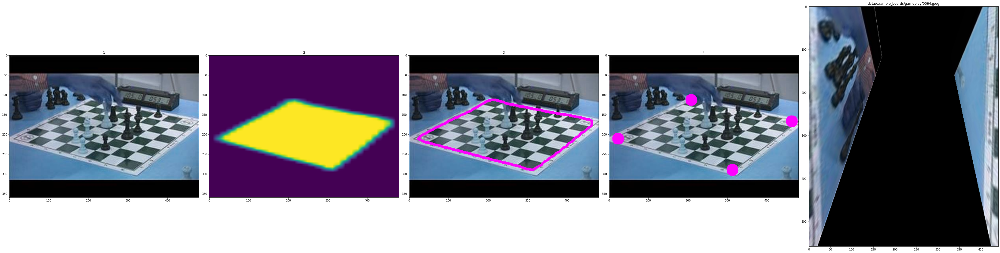

data/example_boards/start_lineups/0047-h-b.jpg


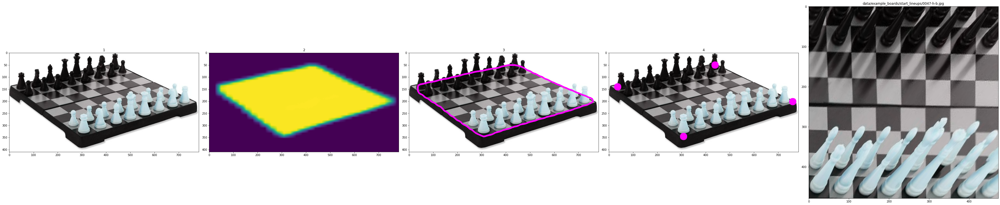

data/example_boards/start_lineups/0012-h-w.jpg


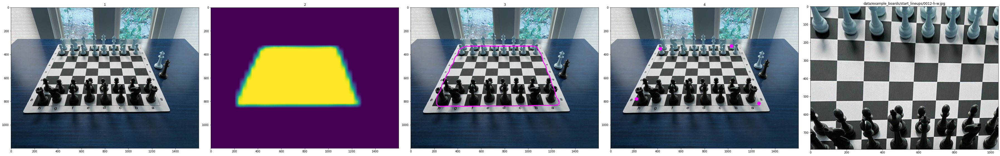

data/example_boards/from_videos/the_game_that_made_magnus_carlsen_the_world_rapid_champion_2019-6o3weoim4m8.mp4-1137.jpeg


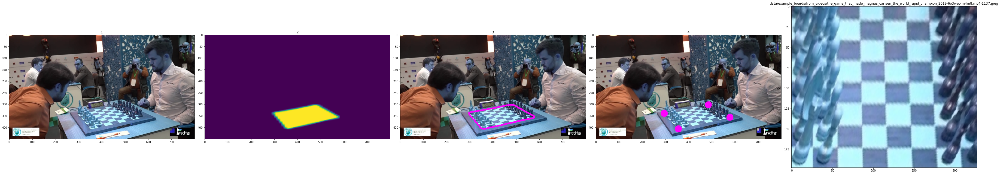

data/example_boards/gameplay/0006.jpeg


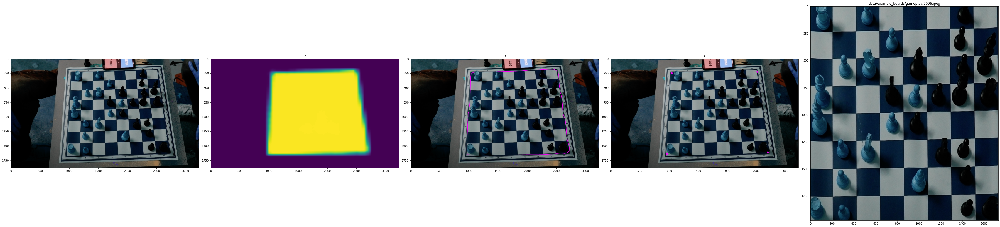

data/example_boards/gameplay/0123.jpeg


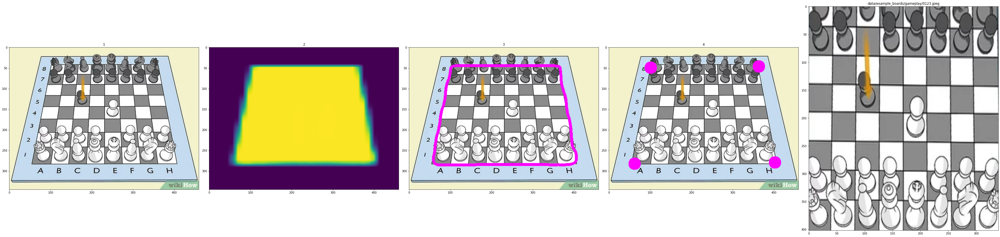

data/example_boards/gameplay/0111.jpeg


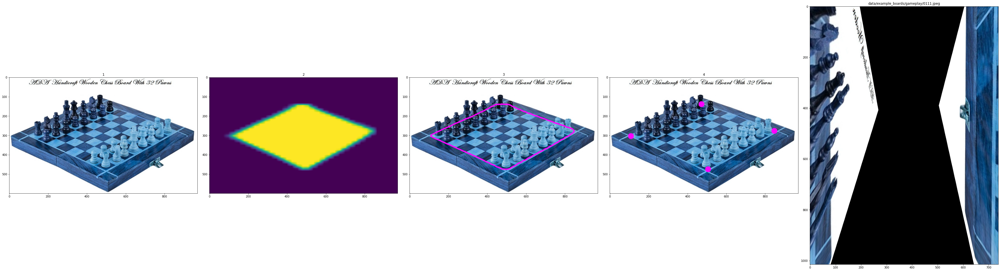

data/example_boards/gameplay/0205.jpg


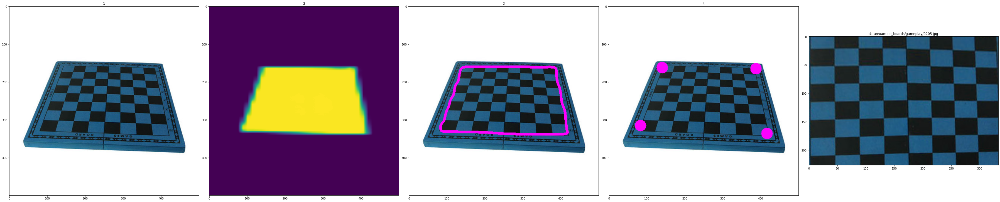

In [241]:
# import math


import math

import numpy as np
from cv2 import cv2
from scipy import spatial


def order_points(pts):
    # sort the points based on their x-coordinates
    x_sorted = pts[np.argsort(pts[:, 0]), :]

    # grab the left-most and right-most points from the sorted
    # x-coodinate points
    left_most = x_sorted[:2, :]
    right_most = x_sorted[2:, :]

    # now, sort the left-most coordinates according to their
    # y-coordinates so we can grab the top-left and bottom-left
    # points, respectively
    left_most = left_most[np.argsort(left_most[:, 1]), :]
    (tl, bl) = left_most
    # now that we have the top-left coordinate, use it as an
    # anchor to calculate the Euclidean distance between the
    # top-left and right-most points; by the Pythagorean
    # theorem, the point with the largest distance will be
    # our bottom-right point

    D = spatial.distance.cdist(tl[np.newaxis], right_most, "euclidean")[0]
    (br, tr) = right_most[np.argsort(D)[::-1], :]
    # return the coordinates in top-left, top-right,
    # bottom-right, and bottom-left order
    return np.array([tl, tr, br, bl], dtype="float32")


def four_point_transform(image, pts):
    # obtain a consistent order of the points and unpack them
    # individually
    pts = order_points(pts)

    p = [pts[0], pts[1], pts[3], pts[2]]

    rows, cols = image.shape[0:2]
    #image center
    u0 = (cols)/2.0
    v0 = (rows)/2.0

    #widths and heights of the projected image
    w1 = scipy.spatial.distance.euclidean(p[0],p[1])
    w2 = scipy.spatial.distance.euclidean(p[2],p[3])

    h1 = scipy.spatial.distance.euclidean(p[0],p[2])
    h2 = scipy.spatial.distance.euclidean(p[1],p[3])

    w = max(w1,w2)
    h = max(h1,h2)

    #visible aspect ratio
    ar_vis = float(w)/float(h)

    #make numpy arrays and append 1 for linear algebra
    m1 = np.array((p[0][0],p[0][1],1)).astype('float32')
    m2 = np.array((p[1][0],p[1][1],1)).astype('float32')
    m3 = np.array((p[2][0],p[2][1],1)).astype('float32')
    m4 = np.array((p[3][0],p[3][1],1)).astype('float32')

    #calculate the focal disrance
    k2 = np.dot(np.cross(m1,m4),m3) / np.dot(np.cross(m2,m4),m3)
    k3 = np.dot(np.cross(m1,m4),m2) / np.dot(np.cross(m3,m4),m2)

    n2 = k2 * m2 - m1
    n3 = k3 * m3 - m1

    n21 = n2[0]
    n22 = n2[1]
    n23 = n2[2]

    n31 = n3[0]
    n32 = n3[1]
    n33 = n3[2]

    f = math.sqrt(np.abs( (1.0/(n23*n33)) * ((n21*n31 - (n21*n33 + n23*n31)*u0 + n23*n33*u0*u0) + (n22*n32 - (n22*n33+n23*n32)*v0 + n23*n33*v0*v0))))

    A = np.array([[f,0,u0],[0,f,v0],[0,0,1]]).astype('float32')

    At = np.transpose(A)
    Ati = np.linalg.inv(At)
    Ai = np.linalg.inv(A)

    #calculate the real aspect ratio
    ar_real = math.sqrt(np.dot(np.dot(np.dot(n2,Ati),Ai),n2)/np.dot(np.dot(np.dot(n3,Ati),Ai),n3))

    if ar_real < ar_vis:
        W = int(w)
        H = int(W / ar_real)
    else:
        H = int(h)
        W = int(ar_real * H)

    pts1 = np.array(p).astype('float32')
    pts2 = np.float32([[0,0],[W,0],[0,H],[W,H]])

    #project the image with the new w/h
    M = cv2.getPerspectiveTransform(pts1,pts2)

    return cv2.warpPerspective(image,M,(W,H))


images = glob("data/example_boards/*/*jp*g")  # data/example_boards/gameplay/0040.jpg
shuffle(images)

for im in images[0:25]:
    print(im)
    img = Image.open(im).convert("RGB")
    img, _ = T.ToTensor()(img)
    img = T.Normalize()(img, (0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    # image, _ = get_transform(train=False)(img, None)
    img = img.to(device)

    with torch.no_grad():
        # image.view(1, image.shape[0], image.shape[1], image.shape[2])
        prediction = model([img])

    # sample = image.permute(1,2,0).data.cpu().numpy()
    boxes = prediction[0]["boxes"].data.cpu().numpy()
    scores = prediction[0]["scores"].data.cpu().numpy()
    masks = prediction[0]["masks"].data.cpu().numpy()

    def angle_cos(p0, p1, p2):
        d1, d2 = (p0-p1).astype('float'), (p2-p1).astype('float')
        return abs( np.dot(d1, d2) / np.sqrt( np.dot(d1, d1)*np.dot(d2, d2) ) )

    for i in range(len(prediction[0]['masks'])):
        # iterate over masks
        mask = prediction[0]['masks'][i, 0]
        mask = mask.mul(255).byte().cpu().numpy()
        mask_orig = mask.copy()
        img = cv2.imread(im)
        img_height, img_width = img.shape[0:2]
        img_orig = img.copy()

        g = cv2.GaussianBlur(mask, (5, 5), 0)
#        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#        contour = max(contours, key=cv2.contourArea)
        #mask = cv2.bilateralFilter(mask, 9, 75, 75)
        _retval, t = cv2.threshold(g, 110, 1, cv2.THRESH_BINARY)
        contours, _hierarchy = cv2.findContours(t, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contour = None
        #for cnt in contours:
       #     img = img_orig.copy()
            #cnt_len = cv2.arcLength(cnt, True)
            #cnt = cv2.approxPolyDP(cnt, 0.05*cnt_len, True)
#            print(len(cnt))
            #if len(cnt) == 4:
            #    cnt = cnt.reshape(-1, 2)
       #     contour = cnt.reshape(-1, 2)
       #     break
#        print(len(contours))
        contour = max(contours, key=cv2.contourArea)

        img_cont = img_orig.copy()
        img_cont = cv2.drawContours(img_cont, [contour], -1, (255, 0, 255), 5)

#        print(len(contour))
        contour_len = cv2.arcLength(contour, True)
        contour = cv2.approxPolyDP(contour, 0.05*contour_len, True)
        contour = contour.reshape(-1, 2)



        #print(len(contour))

        #contour = order_points(contour)
        #contour[0] = (contour[0][0] - 5, contour[0][1] - 5)
        #contour[1] = (contour[1][0] + 5, contour[1][1] - 5)
        #contour[2] = (contour[2][0] + 5, contour[2][1] + 5)
        #contour[3] = (contour[3][0] - 5, contour[3][1] + 5)

#        print(contour)

        #cv2.circle(mask, contour[0], 15, (64, 0, 255), -1)
        #cv2.circle(mask, contour[1], 15, (64, 0, 255), -1)
        #cv2.circle(mask, contour[2], 15, (64, 0, 255), -1)
        #cv2.circle(mask, contour[3], 15, (64, 0, 255), -1)

        cv2.circle(img, contour[0], 15, (255, 0, 255), -1)
        cv2.circle(img, contour[1], 15, (255, 0, 255), -1)
        cv2.circle(img, contour[2], 15, (255, 0, 255), -1)
        cv2.circle(img, contour[3], 15, (255, 0, 255), -1)

#        cv2.drawContours(img, [contour], -1, (0, 0, 0), 3)
#        cv2.drawContours(mask, [contour], -1, (64, 0, 0), 3)
#        cv2.drawContours(mask_orig, [contour], -1, (64, 0, 0), 3)
#        cv2.drawContours(g, [contour], -1, (64, 0, 0), 3)

        #trans = img
        try:
            trans = four_point_transform(img_orig, contour)
        except (ZeroDivisionError, ValueError):
            print("skip", im, "zero div")
            continue

        fig = plt.figure(figsize=(50, 30))

        a_1 = fig.add_subplot(1, 5, 1)
        a_1.set_title(1)
        plt.imshow(img_orig)

        a_1 = fig.add_subplot(1, 5, 2)
        a_1.set_title(2)
        plt.imshow(mask_orig)

        a_2 = fig.add_subplot(1, 5, 3)
        a_2.set_title(3)
        plt.imshow(img_cont)
        fig.tight_layout()

        a_3 = fig.add_subplot(1, 5, 4)
        a_3.set_title(4)
        plt.imshow(img)
        fig.tight_layout()

        a_3 = fig.add_subplot(1, 5, 5)
        a_3.set_title(im)
        plt.imshow(trans)
        fig.tight_layout()

        plt.show()

        break
